# Face and License Plate Blurring - AWS Marketplace Model Package

This Jupyter Notebook offers face and license plate blurring using deep learning detection.

It will also assist you in deploying NavInfo Europe's Model Package from AWS Marketplace.

Example code below can be tailored to your needs, once it can always be reverted back to the original one, as provided by Navinfo Europe B.V.

Intermediate knowledge of AWS SageMaker and Python is required.

## Usage instructions

Run this Jupyter notebook one cell a time and press `Shift+Enter` to run each consecutive cell.

## Pre-requisites

1. This notebook renders correctly in Jupyter Notebook interface, so please open this notebook from an Amazon SageMaker Notebook Instance or Amazon SageMaker Studio.
2. Ensure that IAM role used has `AmazonSageMakerFullAccess`.
3. To deploy this ML model successfully, ensure that:
   1. You are able to make AWS Marketplace subscriptions and our IAM role has the following permissions:
      - `aws-marketplace:ViewSubscriptions`
      - `aws-marketplace:Unsubscribe`
      - `aws-marketplace:Subscribe`
   2. Or your AWS account has a subscription to Face and License Plate Blurring. If so, skip step [Subscribe to the model package](#1.-Subscribe-to-the-model-package).

## Contents

1. [Subscribe to the model package](#1.-Subscribe-to-the-model-package)
2. [Create a new session](#2.-Create-a-new-session)
3. [Create a model](#3.-Create-a-model)
4. [Create an endpoint and perform real-time inference](#4.-Create-an-endpoint-and-perform-real-time-inference)
   1. [Create an endpoint](#A.-Create-an-endpoint)
   2. [Create input payload](#B.-Create-input-payload)
   3. [Perform real-time inference](#C.-Perform-real-time-inference)
   4. [Visualize output](#D.-Visualize-output)
   5. [Delete the endpoint](#E.-Delete-the-endpoint)
5. [Perform batch inference](#5.-Perform-batch-inference) 
   1. [Create input payload using S3](#A.-Create-input-payload-using-S3)
   2. [Perform batch inference](#B.-Perform-batch-inference)
   3. [Retrieve and visualize output](#C.-Retrieve-and-visualize-output)
6. [Clean-up](#6.-Clean-up)
   1. [Delete the model](#A.-Delete-the-model)
   2. [Unsubscribe (optional)](#B.-Unsubscribe-(optional))

### 1. Subscribe to the model package

There are three ways to use subscribed model packages: [Console, API and Sagemaker Python SDK](https://docs.aws.amazon.com/sagemaker/latest/dg/sagemaker-mkt-model-pkg-model.html).

For better visualisation, this notebook mainly uses SageMaker Python SDK.

For GPU instance usage, please use the Console or API, as explained in the link above.

Subscribe to the model package:

1. Open the model package page ["Face and License Plate Blurring"](https://aws.amazon.com/marketplace/pp/prodview-qraiphwo2242e?ref_=beagle&applicationId=AWS-Sagemaker-Console).
2. Click on the **Continue to subscribe** button.
3. On the **Subscribe to this software** page, review it and click on **"Accept Offer"** if you and your organization agree with the EULA, pricing, and support terms.
4. Click on **Continue to configuration button** and then select a **region**. The **Product Arn** will be displayed. **This is the model package ARN that you need to specify while creating a deployable model using Boto3. Copy the ARN corresponding to your region and validate arn printed in "Create a model".**

### 2. Create a new session

Boto is the Amazon Web Services (AWS) SDK for Python that provides an easy to use, object-oriented API, as well as low-level access to AWS services.

Boto creates a new **session** to communicate with our model. This example uses the default (S3) **bucket**, which needs to be defined.

In [5]:
import sagemaker as sage
import os
import boto3

from sagemaker import get_execution_role
from sagemaker import transformer
from sagemaker import model

role = get_execution_role()
sagemaker_session = sage.Session()

bucket = sagemaker_session.default_bucket()
account = sagemaker_session.boto_session.client('sts').get_caller_identity()['Account']
region = sagemaker_session.boto_session.region_name

print(bucket)
print(account)
print(region)

sagemaker-eu-central-1-875741056133
875741056133
eu-central-1


### 3. Create a model

In [6]:
from utils.model_package_arns import ModelPackageArnProvider
from sagemaker import ModelPackage

model_package_arn = ModelPackageArnProvider.get_model_package_arn(sagemaker_session.boto_region_name).split('=')[-1]

print(model_package_arn)

arn:aws:sagemaker:eu-central-1:446921602837:model-package/anonymization-4-0-0-16cab87c95f032708f94ff23454dae21


In [7]:
# Common definitions, needed for both real-time and batch transform inference
model_name = 'anonymization-4-0-0'

# Output blurred image MIME type
# Supported formats: image/jpeg, image/png, mage/jp2, image/tiff
accept = 'image/jpeg' # let's use image/jpeg here

# Input image MIME type
content_type = 'image/jpeg'

In [8]:
from sagemaker import ModelPackage

def predict_wrapper(endpoint, session):
    return sage.Predictor(endpoint, session)

# Create a deployable model from the model package
model = ModelPackage(role=role,
                     model_package_arn=model_package_arn,
                     sagemaker_session=sagemaker_session,
                     predictor_cls=predict_wrapper)

### 4. Create an endpoint and perform real-time inference

This chapter explains how to:  

&nbsp; A. Create endpoint  
&nbsp; B. Prepare input data (images)  
&nbsp; C. Perform real-time inference  
&nbsp; D. Visualize output on this example page  
&nbsp; E. Clean up

To understand how real-time inference with Amazon SageMaker works, see [Documentation](https://docs.aws.amazon.com/sagemaker/latest/dg/how-it-works-hosting.html).

Note: Charging starts when the endpoint is created. To stop getting charged, you have to delete the endpoint.

#### A. Create an endpoint

In [9]:
# This example uses ml.g4dn.xlarge for slower but cheaper inference
real_time_inference_instance_type = 'ml.g4dn.xlarge'

# Deploy the model
predictor = model.deploy(1, real_time_inference_instance_type, endpoint_name=model_name)

-----------------!

If there are errors while using this code for GPU instance usage, please use the Console or API methods, as explained in the link below.  
https://docs.aws.amazon.com/sagemaker/latest/dg/sagemaker-mkt-model-pkg-model.html

#### B. Create input payload

Along with this notebook, there are input images available in the data directory.

In [10]:
!pip install ipyplot

Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com


In [11]:
import glob
import ipyplot

#ipyplot.plot_images(glob.glob('data/input/new/*.jpg'), max_images=20, img_width=150)

#### C. Perform real-time inference

Inference using GPU instances has a much better real-time inference speed performance.

CLI example:

In [12]:
file_name='data/input/new/image10.jpg'

output_file_name='data/output/real-time/output.jpg'

!aws sagemaker-runtime invoke-endpoint \
    --endpoint-name $model_name \
    --body fileb://$file_name \
    --content-type $content_type \
    --accept $accept \
    --region $sagemaker_session.boto_region_name \
    $output_file_name

{
    "ContentType": "image/jpeg",
    "InvokedProductionVariant": "AllTraffic"
}


Python example:

In [13]:
file_name='data/input/new/image10.jpg'

output_file_name = 'data/output/real-time/output.jpg'

# open file and call predict for the image
with open(file_name, 'rb') as image:
    model_input = bytearray(image.read())
    response = predictor.predict(model_input)

try:
    with open(output_file_name, 'wb') as blurred_image_file:
        blurred_image_file.write(response)
except Exception as e:
    print(e)

#### D. Visualize output

Matplotlib is building the font cache; this may take a moment.


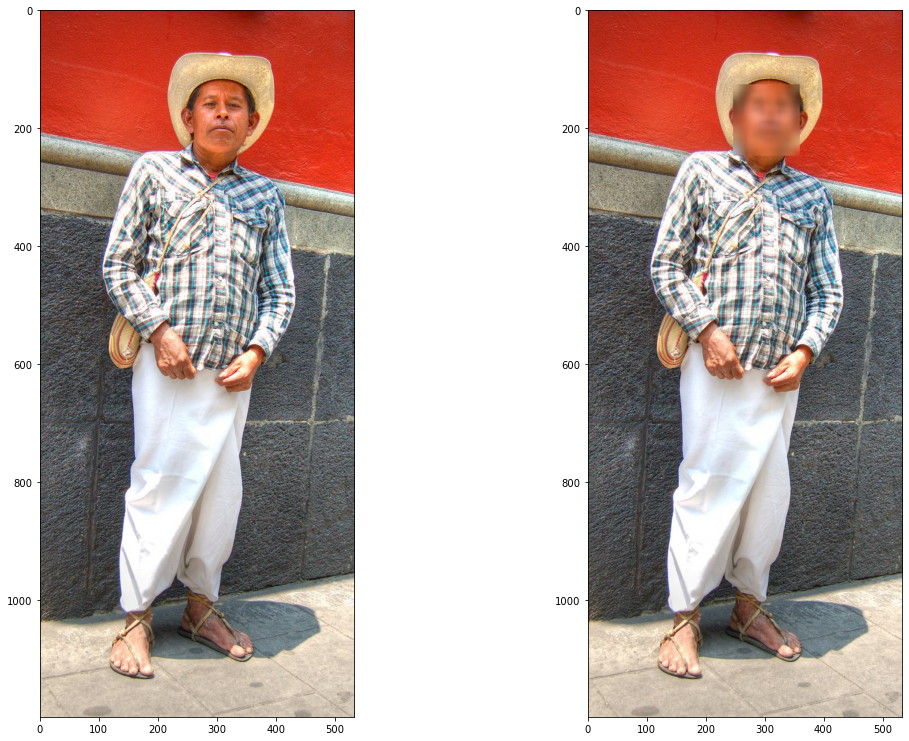

In [14]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib import rcParams

%matplotlib inline

# figure size in inches optional
rcParams['figure.figsize'] = 18, 13

# read images
input_file = mpimg.imread(file_name)
output_file = mpimg.imread(output_file_name)

# display images
fig, ax = plt.subplots(1, 2)
ax[0].imshow(input_file)
ax[1].imshow(output_file)

#### E. Realtime processing of a batch of images

In [15]:
import concurrent.futures
import threading
import time
from os import path

thread_local = threading.local()

ORIG_FRAME_DIR = 'data/input/new/'
OUTPUT_DIR = 'data/output/real-time/'
SAGEMAKER_ENDPOINT = model_name
MAX_WORKERS = 30


def blur_image(image):
    response = predictor.predict(image)
    return response


def blur_all_images(orig_file_list):
    with concurrent.futures.ThreadPoolExecutor(max_workers=MAX_WORKERS) as executor:
        jobs = []
        images = []
        results_done = []

        for idx, image_filename in enumerate(orig_file_list):
            file_path = path.join(ORIG_FRAME_DIR, image_filename)
            with open(file_path, 'rb') as image:
                model_input = bytearray(image.read())
                jobs.append(executor.submit(blur_image, model_input))

        for idx, job in enumerate(concurrent.futures.as_completed(jobs)):
            # Read result from future
            result_done = job.result()
            if idx < 20:
                file_path = path.join(OUTPUT_DIR, f'{idx:02}.jpg')
                with open(file_path, 'wb') as blurred_image_file:
                    blurred_image_file.write(result_done)


def threading_predict():
    orig_file_list = sorted(os.listdir(ORIG_FRAME_DIR))
    orig_file_list = orig_file_list * 1

    start_time = time.time()
    blur_all_images(orig_file_list)
    duration = time.time() - start_time
    print(f'Blurred {len(orig_file_list)} in {duration} seconds')

In [16]:
threading_predict()

Blurred 17 in 3.7462503910064697 seconds


In [17]:
ipyplot.plot_images(glob.glob(OUTPUT_DIR + '*.jpg'), max_images=20, img_width=150)

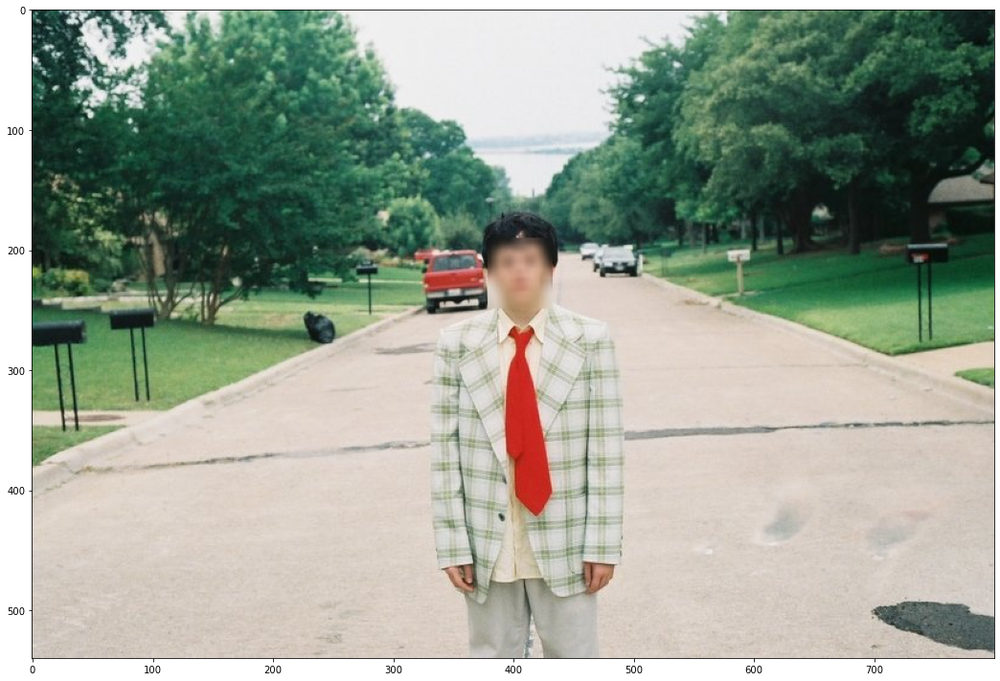

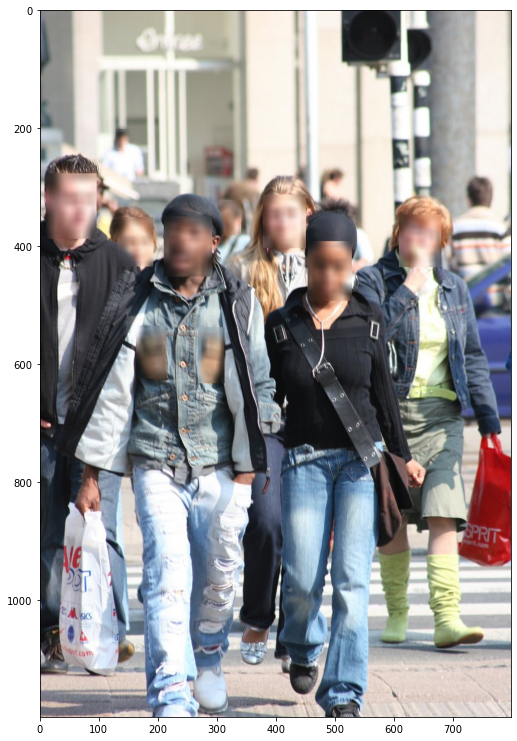

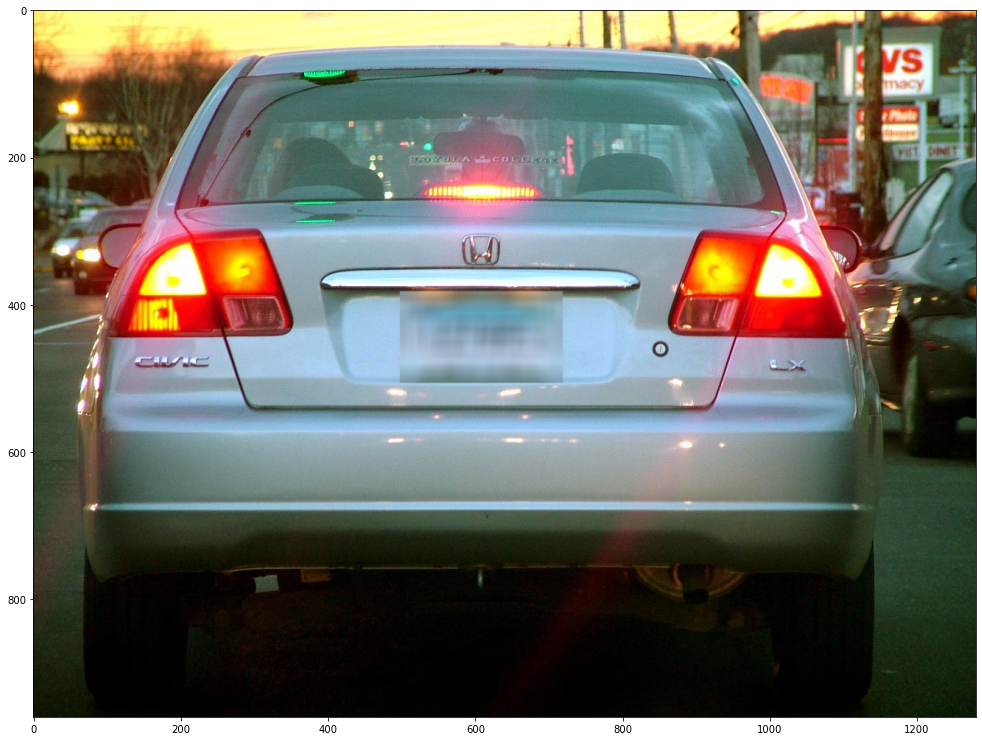

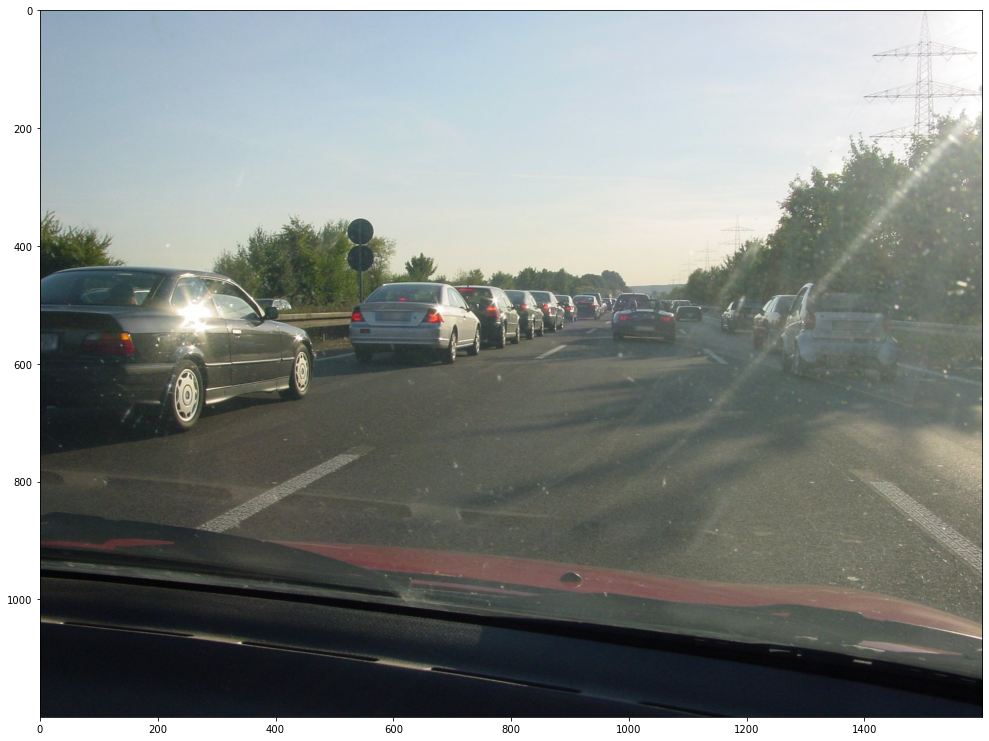

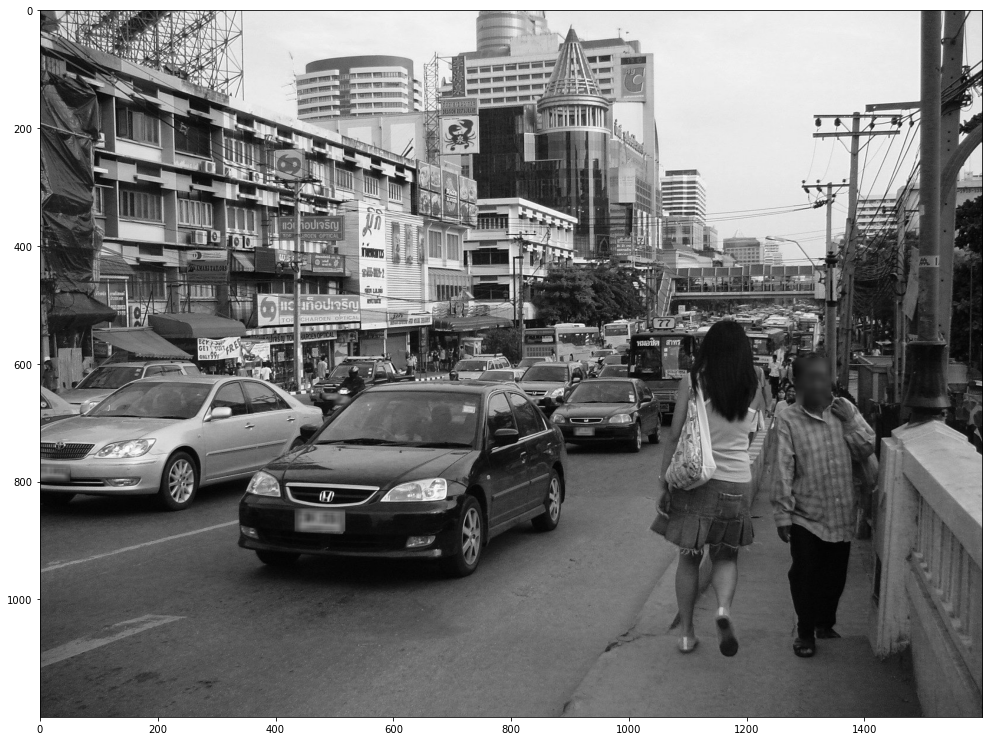

...

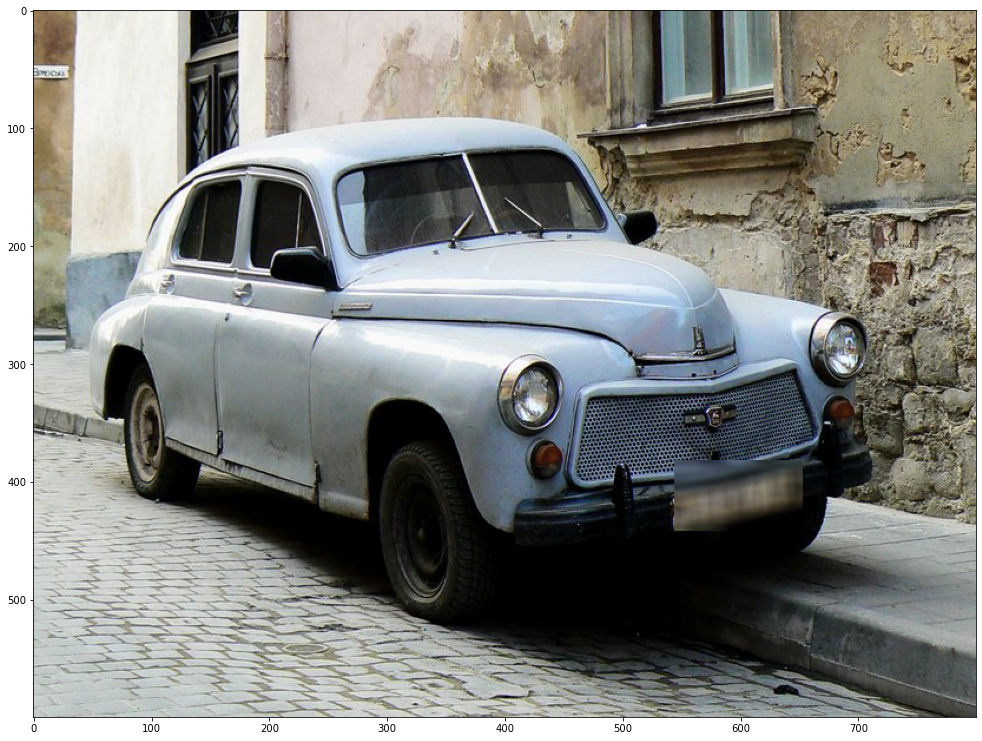

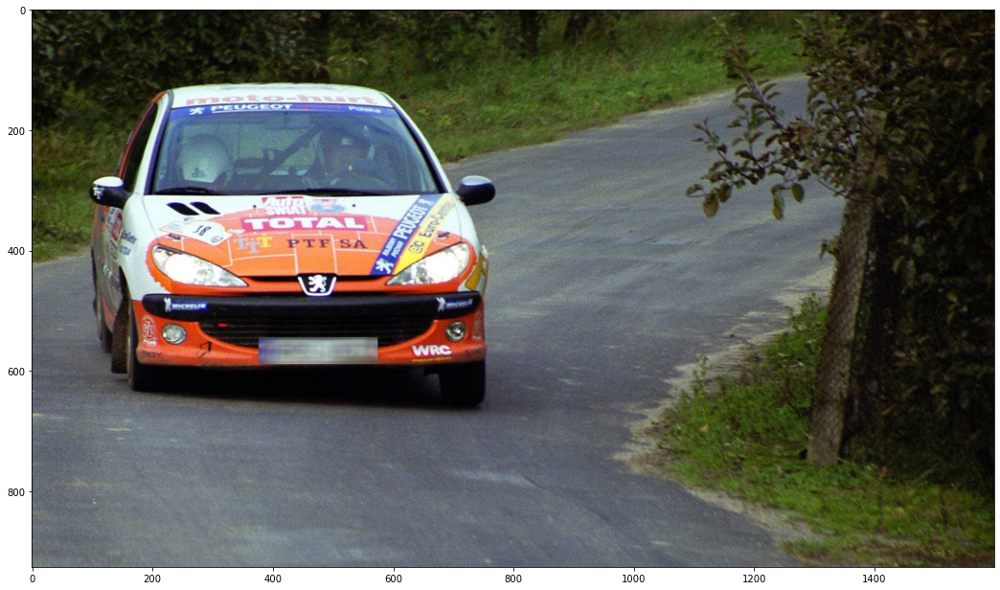

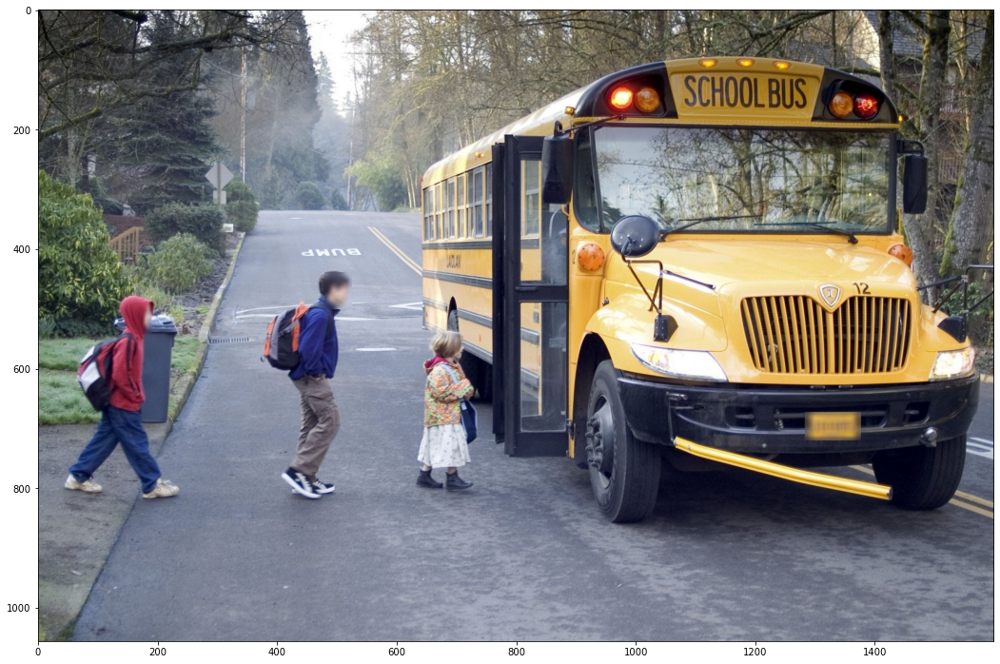

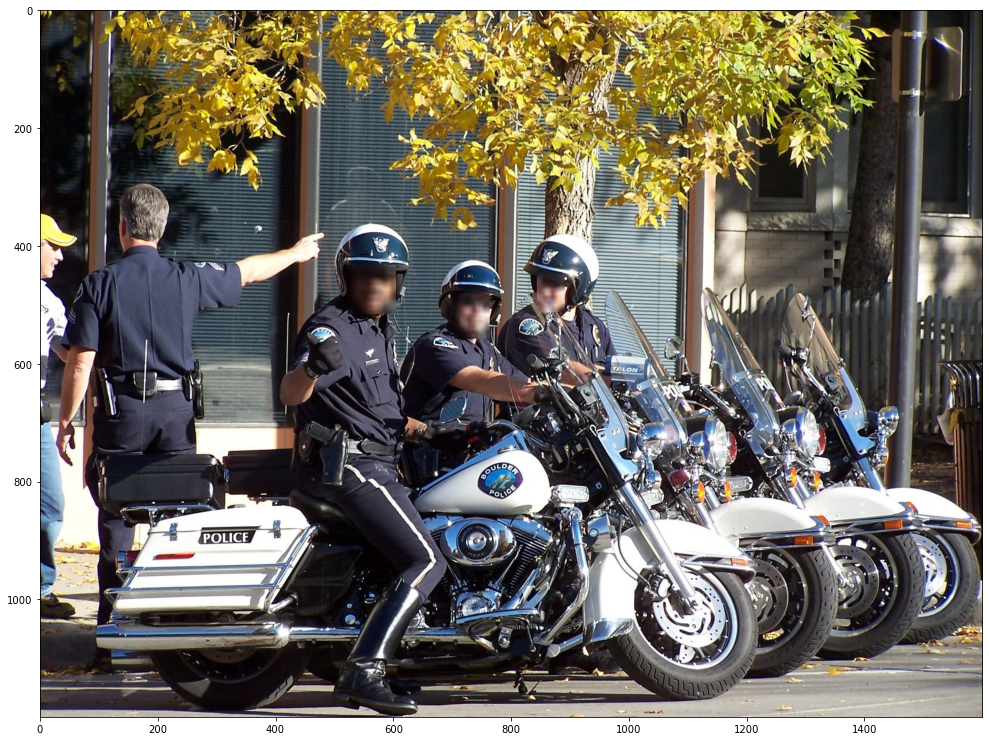

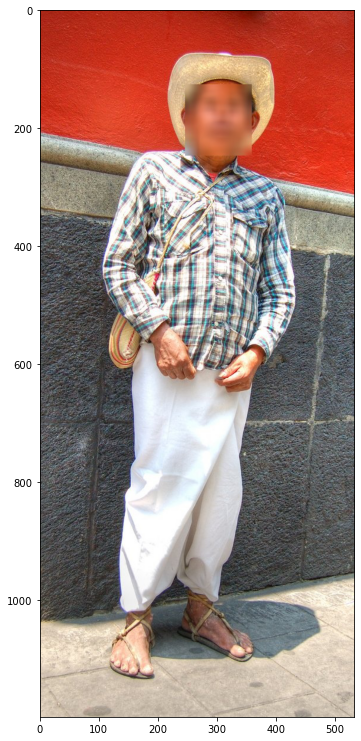

In [18]:
for imageName in glob.glob(OUTPUT_DIR + '*.jpg'):
    img = mpimg.imread(imageName)
    plt.figure()
    plt.imshow(img)

#### E. Delete the endpoint

Stop getting charged by deleting the previously created endpoint.

In [19]:
predictor = sage.Predictor(model_name, sagemaker_session, content_type)
predictor.delete_endpoint(delete_endpoint_config=True)

### 5. Perform batch inference

This chapter explains how to:  

&nbsp; A. Create input payload using S3  
&nbsp; B. Perform batch inference  
&nbsp; C. Retrieve and visualize output

Clean up is not required.

If you are not familiar with batch transform, learn more at:

1. [How it works](https://docs.aws.amazon.com/sagemaker/latest/dg/ex1-batch-transform.html)
2. [How to run a batch transform job](https://docs.aws.amazon.com/sagemaker/latest/dg/how-it-works-batch.html)

Inference using GPU instances has much better batch inference speed performance.  
You are only charged for the duration of the batch job.  
Moreover, each job takes additional time to initialize.

#### A. Create input payload using S3

Upload the batch-transform job input files to S3.

In [20]:
transform_input_folder = 'data/input/new'
transform_input = sagemaker_session.upload_data(transform_input_folder, key_prefix=model_name) 

print("Transform input uploaded to " + transform_input)

Transform input uploaded to s3://sagemaker-eu-central-1-875741056133/anonymization-4-0-0


#### B. Perform batch inference

Update according to instance types below:

In [21]:
# Support real time inference with ml.p3.2xlarge (preferred)
batch_transform_inference_instance_type = 'ml.p3.2xlarge'

transform_output_folder = 'face_license_plate_blurring/batch_transform_output'

output_path = "s3://{}/{}".format(sagemaker_session.default_bucket(), transform_output_folder)

# Run the batch-transform job
# Output logging will be shown below
transformer = model.transformer(instance_count=1, 
                                instance_type=batch_transform_inference_instance_type,
                                output_path=output_path,
                                accept=accept,
                                max_concurrent_transforms=5)

transformer.transform(transform_input, content_type=content_type)
transformer.wait()

.............................................2022-01-12 16:48:33,489 [INFO ] W-7-model.twin_engine - Engine does not exist - build started

/home/ml/model/nanodet2.onnx
Beginning ONNX file parsing
Completed parsing of ONNX file
input.1 - OptProfile 0 - Min (1, 3, 512, 512) Opt (1, 3, 512, 512) Max (1, 3, 512, 512)
Building an engine...
Completed creating Engine in 33.7 s
Successfully saved engine at /home/ml/model/nanodet2.trt
2022-01-12 16:49:08,397 [INFO ] W-7-model.twin_engine - Engine build time taken: 34s
2022-01-12 16:49:08,605 [INFO ] W-1-__main__ - Starting the inference server with 5 workers.
2022/01/12 16:49:08 [crit] 18#18: *1 connect() to unix:/tmp/gunicorn.sock failed (2: No such file or directory) while connecting to upstream, client: 169.254.255.130, server: , request: "GET /ping HTTP/1.1", upstream: "http://unix:/tmp/gunicorn.sock:/ping", host: "169.254.255.131:8080"
169.254.255.130 - - [12/Jan/2022:16:49:08 +0000] "GET /ping HTTP/1.1" 502 49 "-" "Go-http-client/1.1"
20

#### C. Retrieve and visualize output

Output will be available in the following path.

In [22]:
transformer.output_path

's3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output'

In [23]:
!aws s3 sync s3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output ./data/output/batch

In [24]:
ipyplot.plot_images(glob.glob('data/output/batch/*.jpg.out'), max_images=20, img_width=150)

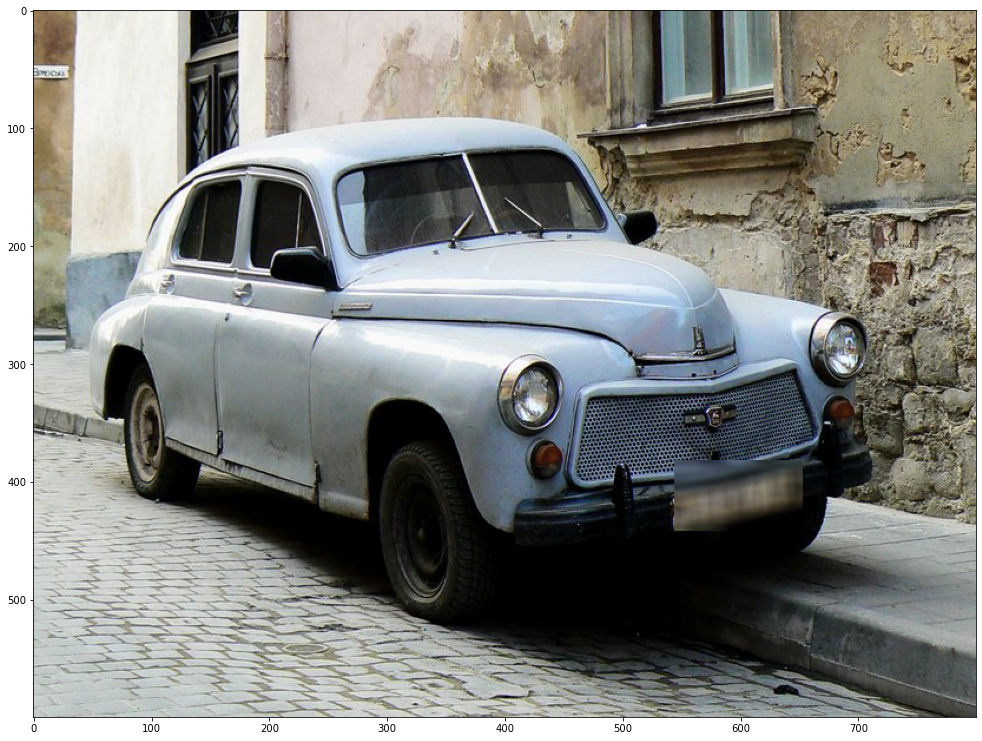

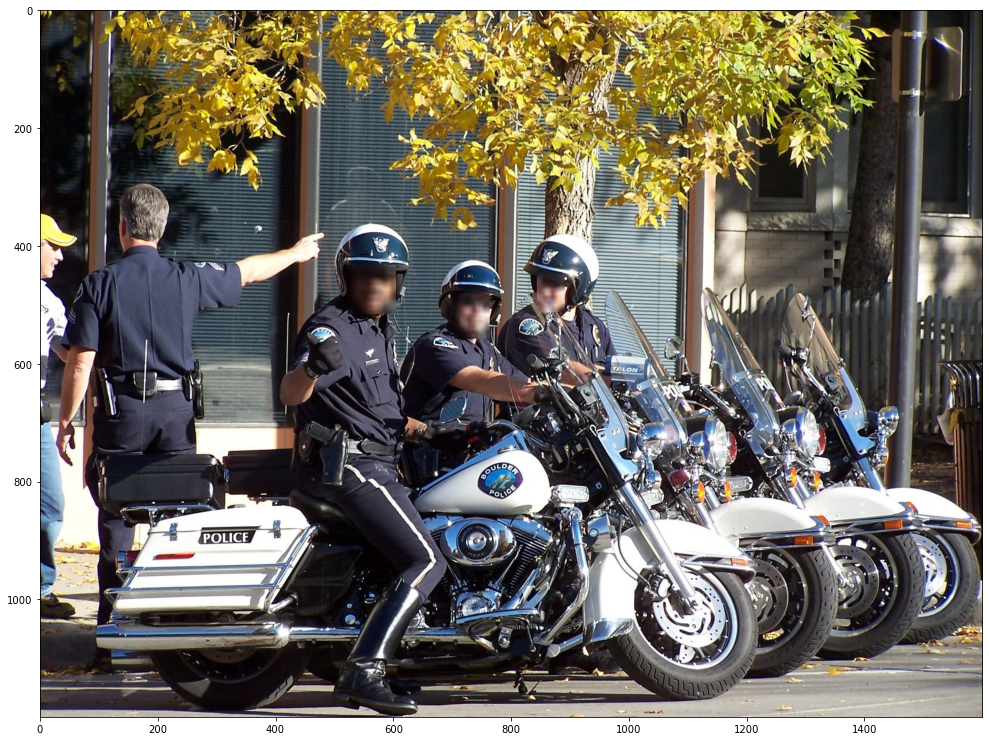

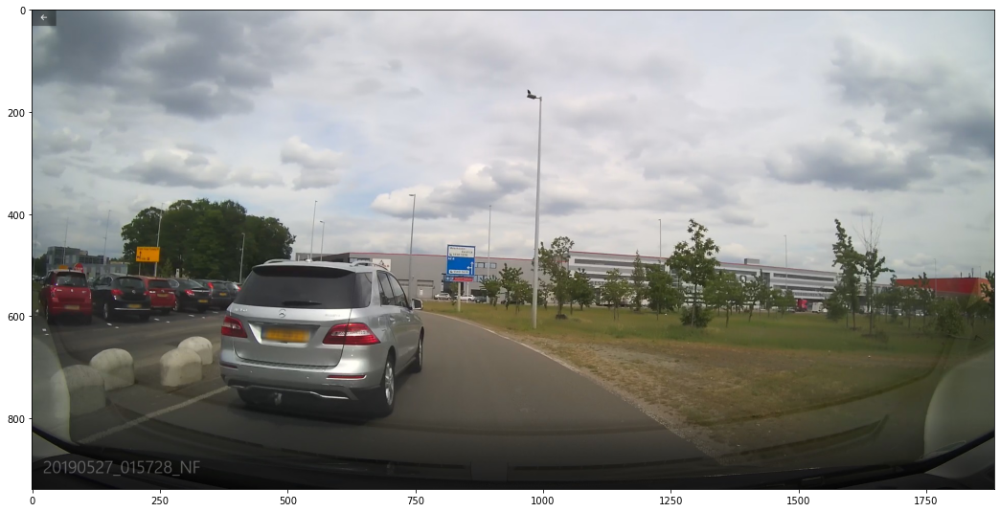

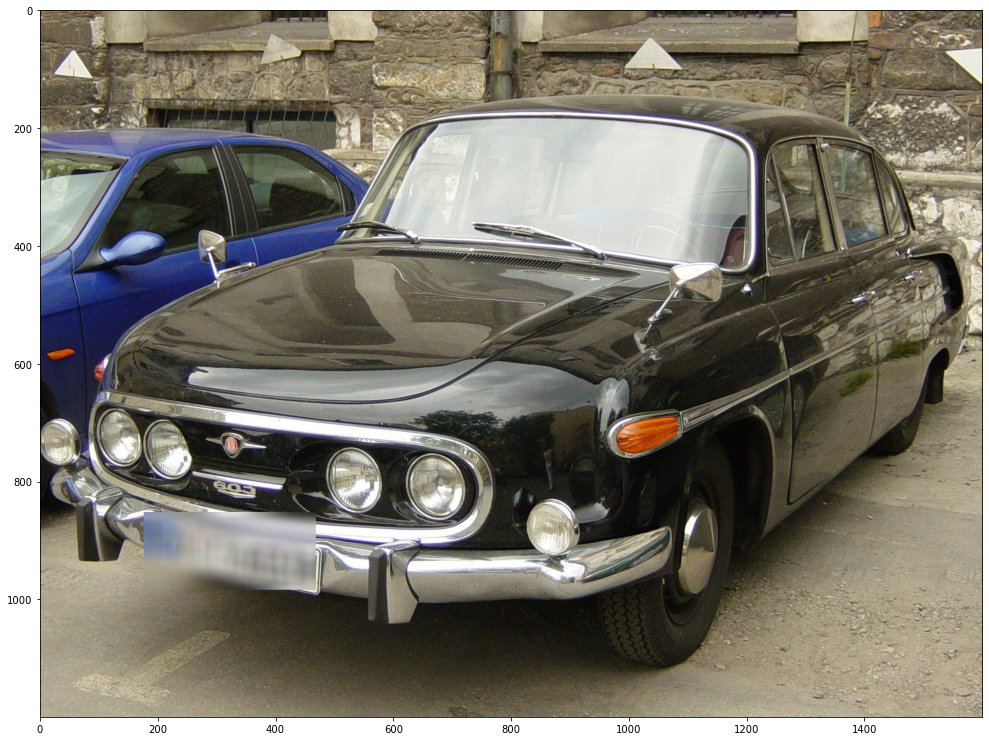

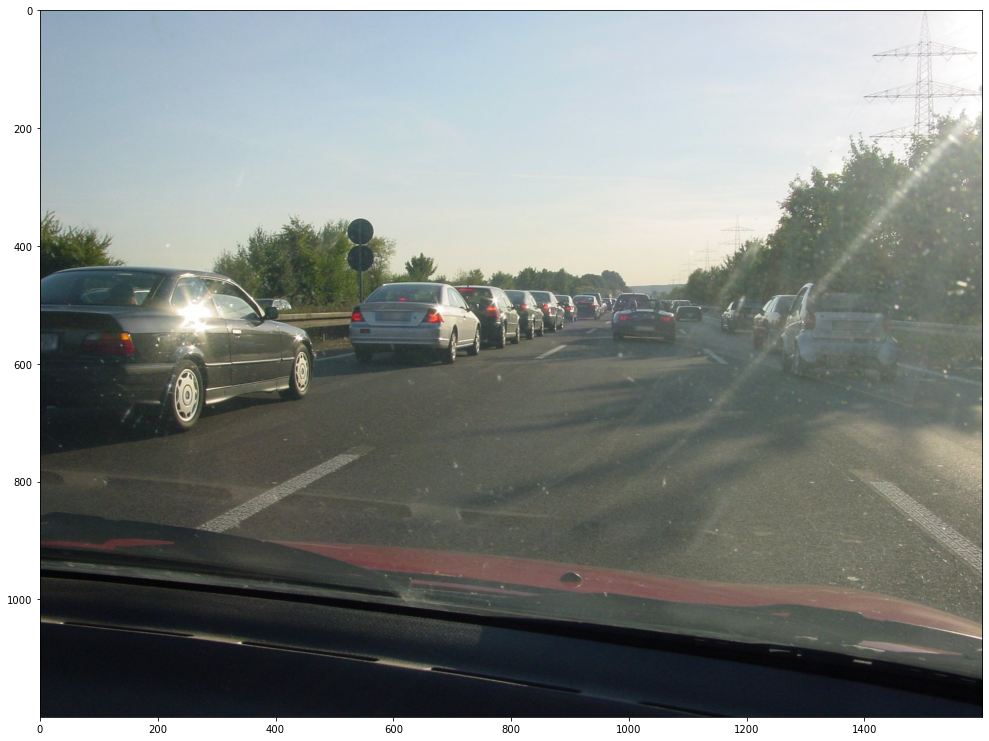

...

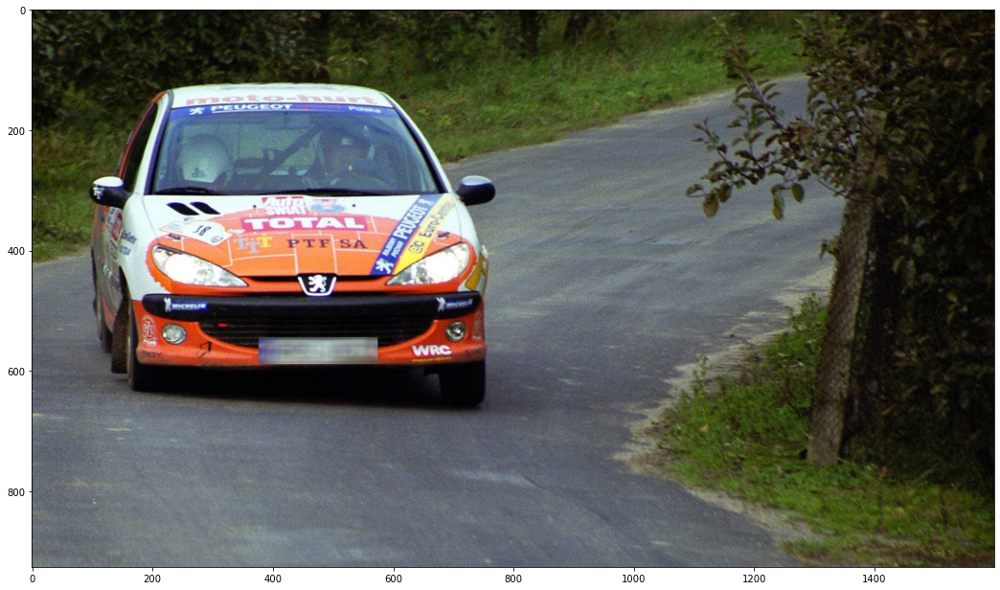

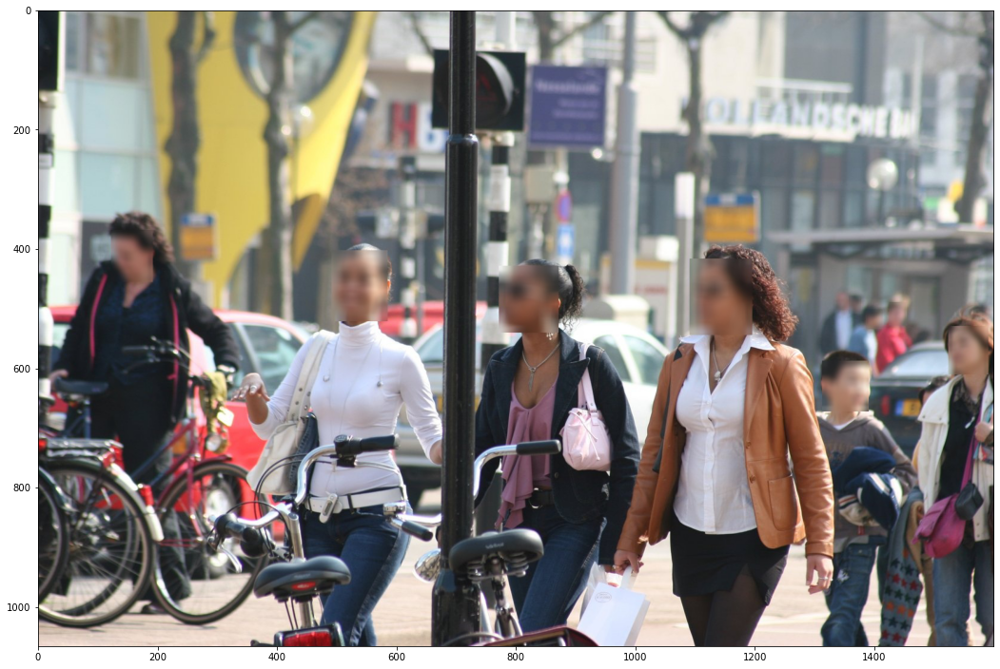

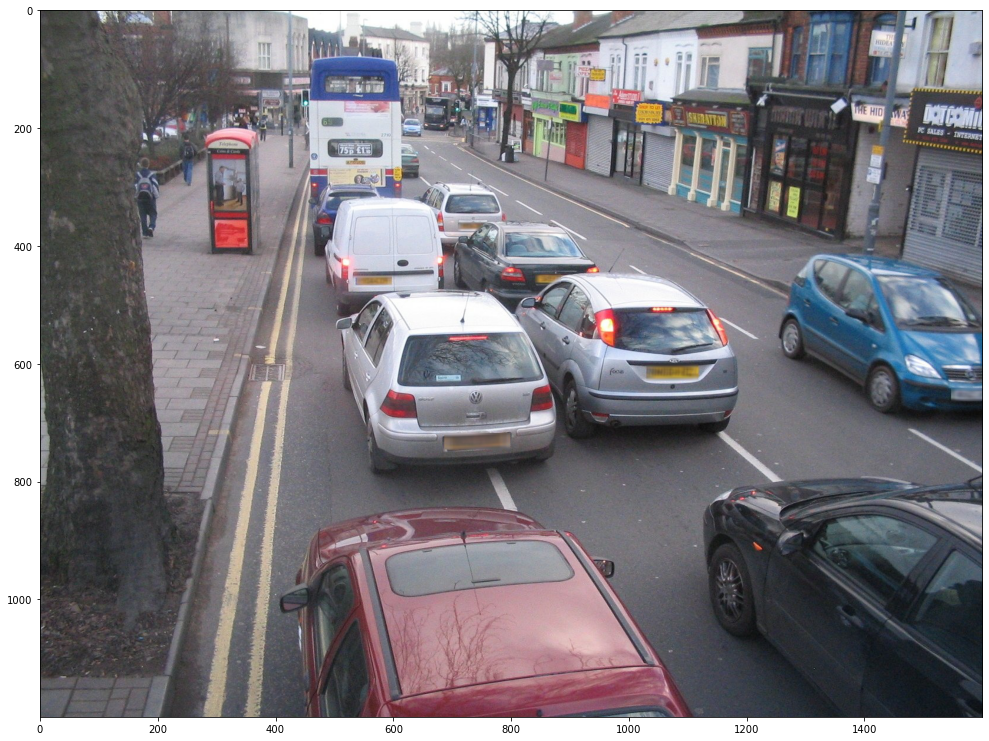

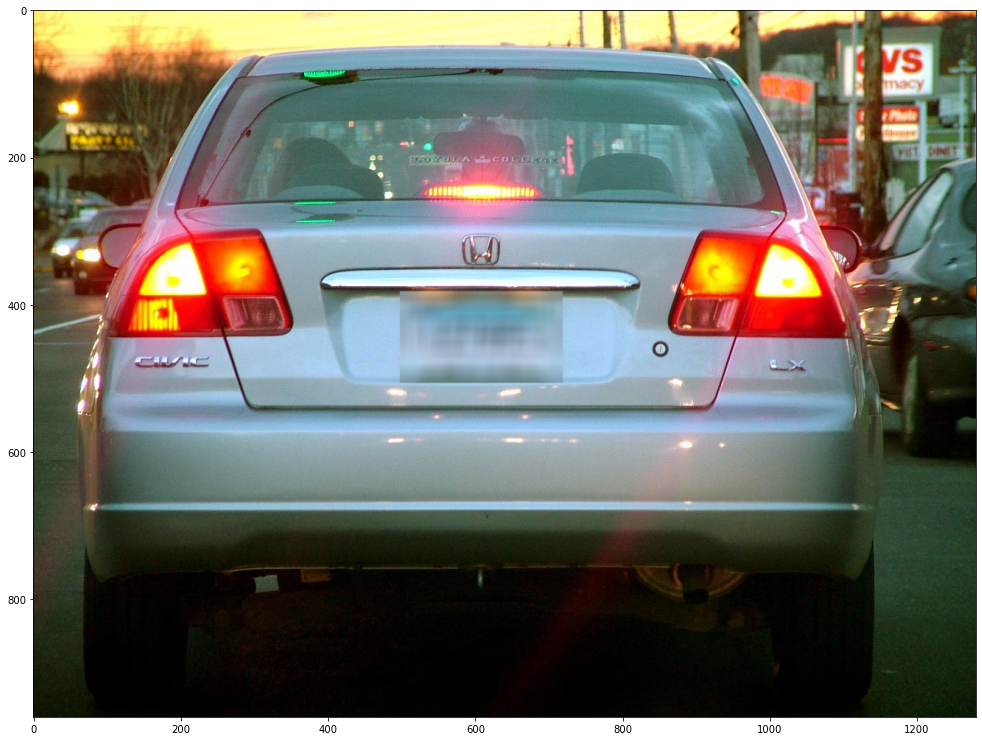

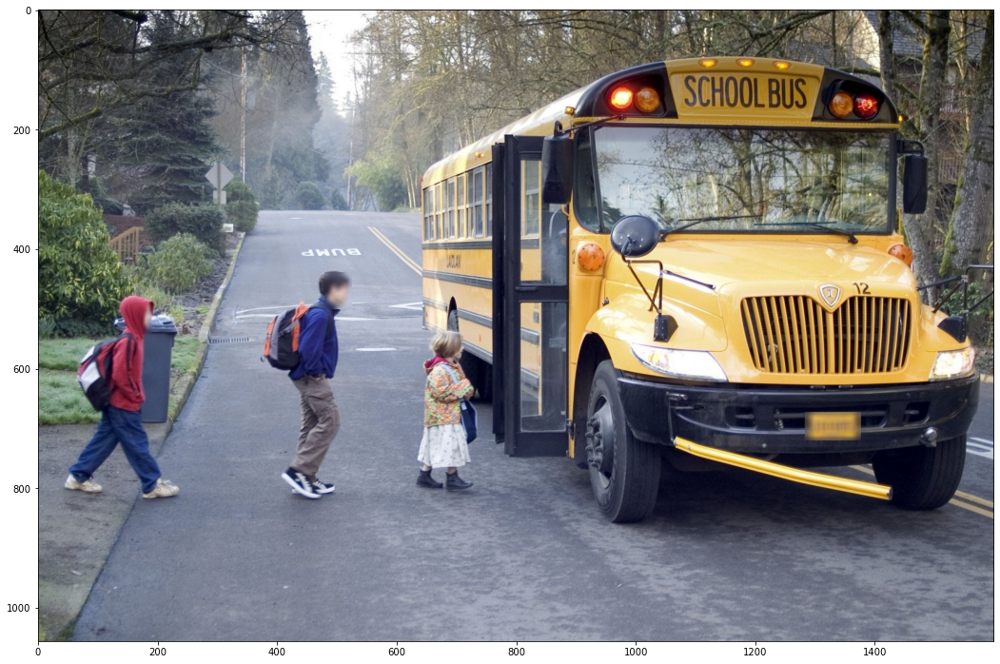

In [25]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

for imageName in glob.glob('data/output/batch/*.jpg.out'):
    img = mpimg.imread(imageName)
    plt.figure()
    plt.imshow(img)

### 6. Clean-up

#### A. Delete the model

In [26]:
model.delete_model()

#### B. Unsubscribe (optional)

Before you cancel the subscription, ensure that you do not have a [running model](https://console.aws.amazon.com/sagemaker/home#/models) or are using the algorithm.

Note: You can find this information by looking at the container name associated with the model. 

Steps to unsubscribe this product from AWS Marketplace:

1. Navigate to __Machine Learning__ tab on [Your Software Subscriptions](https://aws.amazon.com/marketplace/ai/library?productType=ml&ref_=mlmp_gitdemo_indust) page.
2. Locate the listing that you want to cancel the subscription for, then choose __Cancel Subscription__  to cancel the subscription.

Sample dataset contains images from [freeimages.com](https://freeimages.com).